# Lena Bohman - HW 3


In [8]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import PIL.Image as Image

# we won't use these packages directly, but the function that picks colors will
import scipy
import scipy.misc
import scipy.cluster

# If you haven't yet, you may need to install scipy
#!conda install -c anaconda scipy


# NOTE: I am not expecting you to know how to write these on your own!
def quantizetopalette(silf, palette, dither=False):
    """Convert an RGB or L mode image to use a given P image's palette."""
    # refs:
    # [1] https://stackoverflow.com/questions/29433243/convert-image-to-specific-palette-using-pil-without-dithering

    silf.load()

    # use palette from reference image
    palette.load()
    if palette.mode != "P":
        raise ValueError("bad mode for palette image")
    if silf.mode != "RGB" and silf.mode != "L":
        raise ValueError(
            "only RGB or L mode images can be quantized to a palette"
            )
    im = silf.im.convert("P", 1 if dither else 0, palette.im)
    # the 0 above means turn OFF dithering

    # Later versions of Pillow (4.x) rename _makeself to _new
    try:
        return silf._new(im)
    except AttributeError:
        return silf._makeself(im)


def convert_image(image, ncolors = 8):
    # refs:
    # [1]: https://stackoverflow.com/questions/3241929/python-find-dominant-most-common-color-in-an-image
    image = image.convert('RGB') # can't use alpha channel
    NUM_CLUSTERS = ncolors # unnecessary re-naming
    
    ar = np.array(image) # to data
    
    shape = ar.shape
    ar = ar.reshape(np.product(shape[:2]), shape[2]).astype(float)

    print('finding ' + str(ncolors) + ' most common colors.  Note, if "ncolors" is large, this can take a while...')
    codes, dist = scipy.cluster.vq.kmeans(ar, NUM_CLUSTERS)
    print('Done finding colors! cluster centres in RGB:\n', codes)

    vecs, dist = scipy.cluster.vq.vq(ar, codes)         # assign codes
    counts, bins = np.histogram(vecs, len(codes))    # count occurrences
    
    # into a 256 palette, integer types
    reds = np.round(np.interp(np.linspace(0,255,256), np.linspace(0,NUM_CLUSTERS-1,NUM_CLUSTERS), codes[:,0])).astype('int')
    greens = np.round(np.interp(np.linspace(0,255,256), np.linspace(0,NUM_CLUSTERS-1,NUM_CLUSTERS), codes[:,1])).astype('int')
    blues = np.round(np.interp(np.linspace(0,255,256), np.linspace(0,NUM_CLUSTERS-1,NUM_CLUSTERS), codes[:,2])).astype('int')

    # palette formatting:
    myPalette = []
    for i in range(256):
        myPalette.extend( (reds[i],greens[i],blues[i]))
        
    palimage = Image.new('P', (16, 16)) # placeholder image
    palimage.putpalette(myPalette)
    newimage = quantizetopalette(image, palimage, dither=False)
    newimage = newimage.convert('RGB')
    return newimage, codes

# similar to above, but allows you to import your own RGB sequence
def convert_image_specific(image, colors = [ [255, 255, 255], [255, 0, 0], [0,0,255], [0, 0, 0] ]):
    image = image.convert('RGB') # can't use alpha channel
    NUM_CLUSTERS = len(colors) # unnecessary re-naming
    codes = np.array(colors) # unnecessary renaming
    
    # into a 256 palette, integer types
    reds = np.round(np.interp(np.linspace(0,255,256), np.linspace(0,NUM_CLUSTERS-1,NUM_CLUSTERS), codes[:,0])).astype('int')
    greens = np.round(np.interp(np.linspace(0,255,256), np.linspace(0,NUM_CLUSTERS-1,NUM_CLUSTERS), codes[:,1])).astype('int')
    blues = np.round(np.interp(np.linspace(0,255,256), np.linspace(0,NUM_CLUSTERS-1,NUM_CLUSTERS), codes[:,2])).astype('int')

    # palette formatting:
    myPalette = []
    for i in range(256):
        myPalette.extend( (reds[i],greens[i],blues[i]))
        
    palimage = Image.new('P', (16, 16)) # placeholder image
    palimage.putpalette(myPalette)
    newimage = quantizetopalette(image, palimage, dither=False)
    newimage = newimage.convert('RGB')
    return newimage, codes

## Image 1: Basket 1

In [9]:
path_to_image = "basket1.jpg"

In [10]:
im = Image.open(path_to_image)

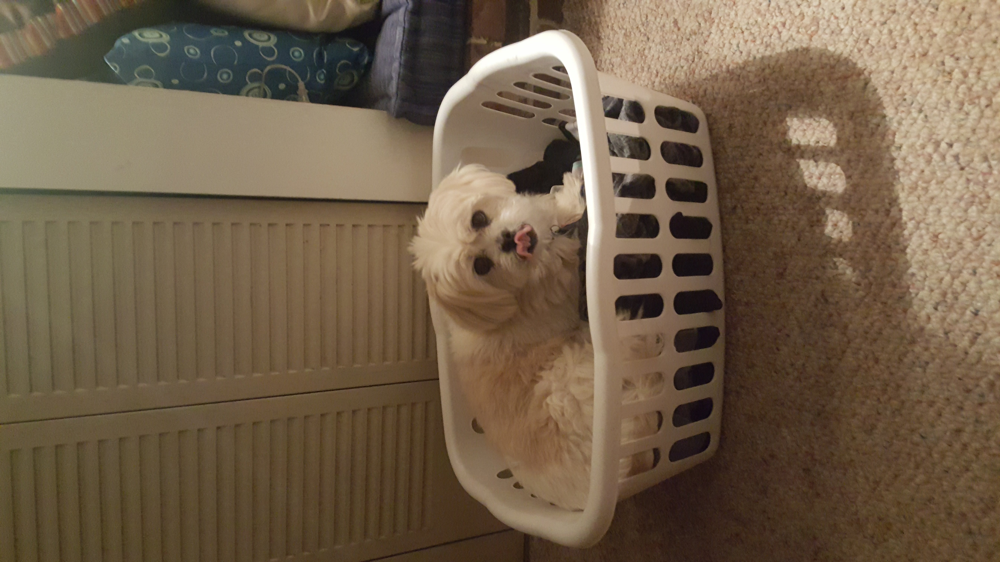

In [11]:
im

In [12]:
new_im, new_rgbs = convert_image(im, ncolors = 8)

finding 8 most common colors.  Note, if "ncolors" is large, this can take a while...
Done finding colors! cluster centres in RGB:
 [[243.70299757 240.78014778 232.66811706]
 [195.04874826 173.86937202 146.9448546 ]
 [111.79476227  90.76531139  66.33510006]
 [ 70.96027332  53.7264715   36.39271287]
 [160.07337954 142.01044523 115.65320885]
 [130.79990146 110.0703961   84.56553786]
 [ 91.788326    72.92199272  49.98446493]
 [ 40.83231922  31.15536487  26.66647909]]


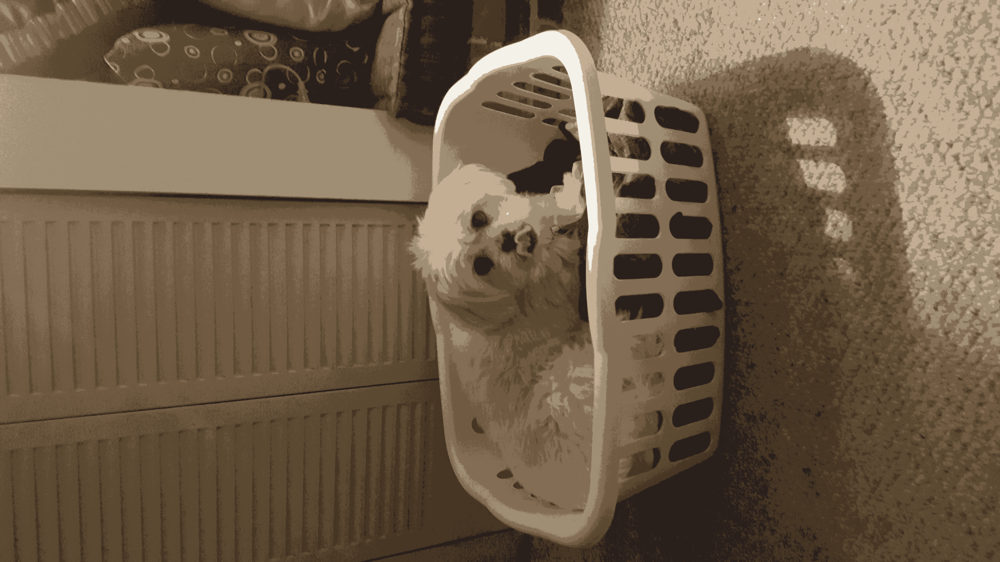

In [13]:
new_im

In [14]:
new_im_data = np.array(new_im)

In [15]:
unique_colors = np.unique(new_im_data.reshape(-1, new_im_data.shape[2]), axis=0)

In [16]:
number_of_pixels_of_a_color = [] #from week 2 class notebook
color_labels = []
color_values = [] 

In [19]:
#from week 2 class notebook
for icolor, rgba in enumerate(unique_colors):
    #print(icolor, rgba)
    reds_mask = new_im_data[:,:,0] == rgba[0] # [all of the y pixels, all of the x pixels, 0th RGBA = R]
    green_mask = new_im_data[:,:,1] == rgba[1] # [all of the y pixels, all of the x pixels, 1st RGBA = G]
    blue_mask = new_im_data[:,:,2] == rgba[2] # [all of the y pixels, all of the x pixels, 2nd RGBA = B]
    
    pixel_mask = reds_mask & green_mask & blue_mask
    
    # count all the pixels of a particular color
    npixels = len(new_im_data[pixel_mask])
    
    # store number of pixels in this rgba combo
    number_of_pixels_of_a_color.append(npixels)
    # naming colors
    color_labels.append("Color #" + str(icolor))
    # color values
    color_values.append(rgba/255) # just for matplotlib color stuff -> converting from 0->255 to 0->1.0

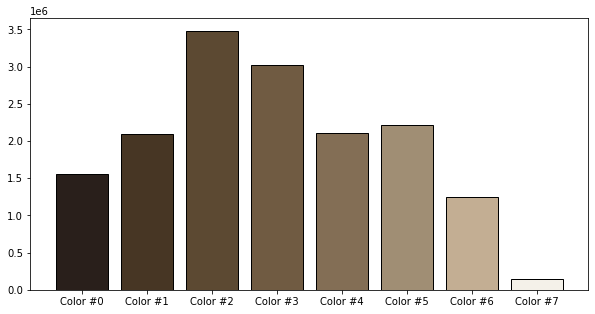

In [21]:
fig, ax = plt.subplots(figsize=(10,5))

ax.set_facecolor('white')
myBarChart = ax.bar(color_labels, number_of_pixels_of_a_color) # creating the barchart but NOT plotting yet...

for i in range(len(myBarChart)): # looping through all of the bars of my barchart...
    myBarChart[i].set_color(color_values[i]) # setting the color of the ith barchart to the list of colors
    myBarChart[i].set_edgecolor('black')

plt.show()

### Discussion
This isn't that different from the corgi picture example. It is also a very brown picture, I think partially because of the lighting. This picture was taken in my room in my mom's house, which has extremely yellow lighting, especially the lamp directly above Baxter in this picture, and the rug and closets in this room are also brown. This picture was also taken at night rather than in natural light.

## Image 2

In [22]:
path_to_image = "basket2.jpg"

In [23]:
im = Image.open(path_to_image)

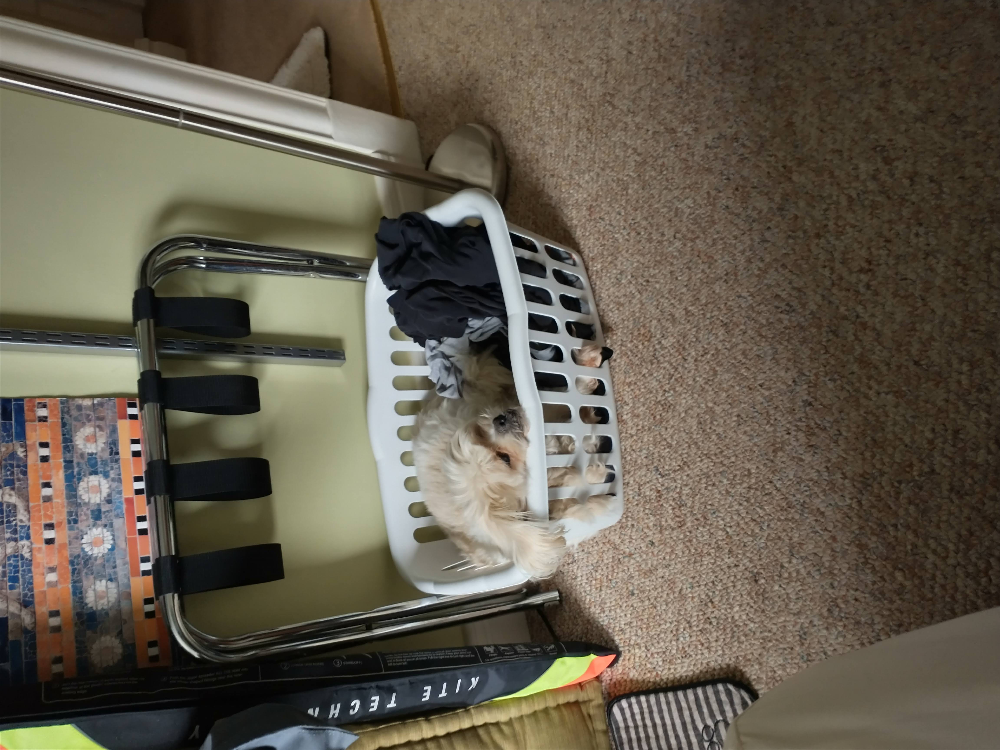

In [24]:
im

In [25]:
new_im, new_rgbs = convert_image(im, ncolors = 8)

finding 8 most common colors.  Note, if "ncolors" is large, this can take a while...
Done finding colors! cluster centres in RGB:
 [[100.91424512  90.58343772  75.22721295]
 [ 52.8294904   44.33782749  33.14796048]
 [151.05469097 143.35962418 121.87299612]
 [ 73.5504127   64.42775462  49.9470541 ]
 [199.76507848 205.06161657 202.47519942]
 [126.54781591 114.24195978  96.97102363]
 [ 17.44153473  17.60609841  16.29133474]
 [175.70407915 172.7500723  151.49004756]]


In [26]:
new_im_data = np.array(new_im)

In [27]:
unique_colors = np.unique(new_im_data.reshape(-1, new_im_data.shape[2]), axis=0)

In [28]:
number_of_pixels_of_a_color = [] #from week 2 class notebook
color_labels = []
color_values = [] 

In [29]:
#from week 2 class notebook
for icolor, rgba in enumerate(unique_colors):
    #print(icolor, rgba)
    reds_mask = new_im_data[:,:,0] == rgba[0] # [all of the y pixels, all of the x pixels, 0th RGBA = R]
    green_mask = new_im_data[:,:,1] == rgba[1] # [all of the y pixels, all of the x pixels, 1st RGBA = G]
    blue_mask = new_im_data[:,:,2] == rgba[2] # [all of the y pixels, all of the x pixels, 2nd RGBA = B]
    
    pixel_mask = reds_mask & green_mask & blue_mask
    
    # count all the pixels of a particular color
    npixels = len(new_im_data[pixel_mask])
    
    # store number of pixels in this rgba combo
    number_of_pixels_of_a_color.append(npixels)
    # naming colors
    color_labels.append("Color #" + str(icolor))
    # color values
    color_values.append(rgba/255) # just for matplotlib color stuff -> converting from 0->255 to 0->1.0

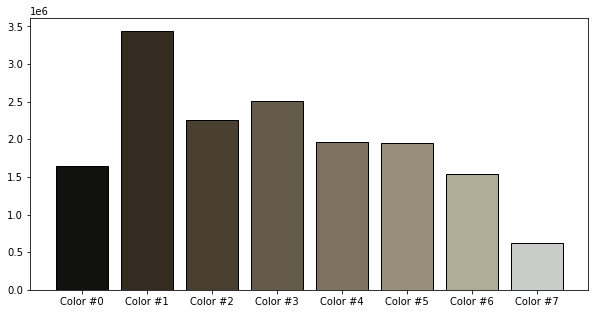

In [30]:
fig, ax = plt.subplots(figsize=(10,5))

ax.set_facecolor('white')
myBarChart = ax.bar(color_labels, number_of_pixels_of_a_color) # creating the barchart but NOT plotting yet...

for i in range(len(myBarChart)): # looping through all of the bars of my barchart...
    myBarChart[i].set_color(color_values[i]) # setting the color of the ith barchart to the list of colors
    myBarChart[i].set_edgecolor('black')

plt.show()

### Discussion
I wanted to compare these two photos, which have the same subject and were taken in the same room, but one at night and one during the day, with very different lighting tones. I was surprised by the outcome, I thought this second one would have a much wider variety of colors and be much lighter. I think maybe what this histogram shows is that the second image has both much more dark and light colors, much stronger contrasts than the first image, which is basically all beige. I'm not sure why this would make it appear lighter, though -- I don't know enough about color theory to say.

I was also surprised there wasn't more variation in the colors in this image. The green color seems very dominant visually but isn't in the histogram except as the gray-ish tone of # 7.

## Image 3

In [31]:
path_to_image = "baxter.jpg"

In [32]:
im = Image.open(path_to_image)

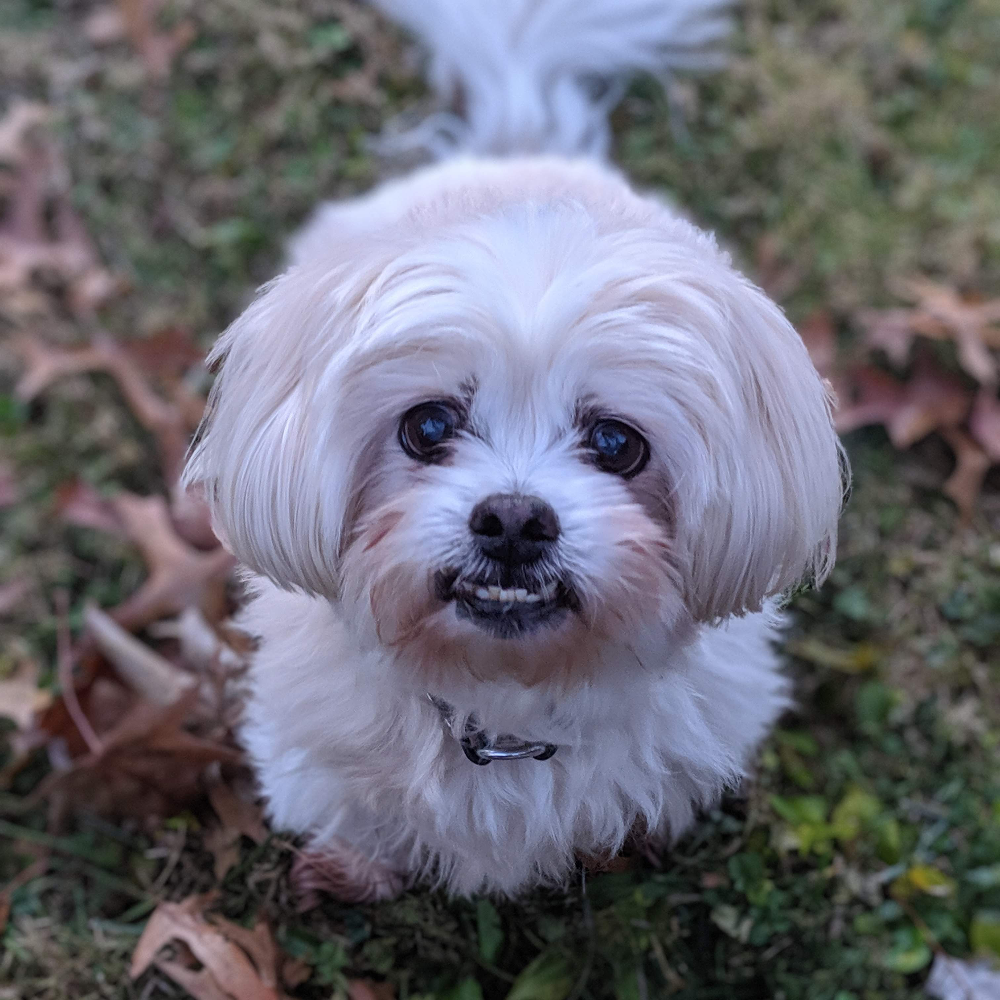

In [33]:
im

In [34]:
new_im, new_rgbs = convert_image(im, ncolors = 8)

finding 8 most common colors.  Note, if "ncolors" is large, this can take a while...
Done finding colors! cluster centres in RGB:
 [[143.36090257 142.45075434 169.30932255]
 [ 51.50360475  51.8406795   46.71990873]
 [ 99.00643459  96.05745553  93.76467168]
 [ 77.31355921  75.2946863   70.39288933]
 [121.11382677 114.94695901 125.91036127]
 [199.1345352  205.79760863 242.42833206]
 [ 24.73542344  25.16427555  23.46917759]
 [166.43681197 171.81120721 208.77577617]]


In [35]:
new_im_data = np.array(new_im)

In [36]:
unique_colors = np.unique(new_im_data.reshape(-1, new_im_data.shape[2]), axis=0)

In [37]:
number_of_pixels_of_a_color = [] #from week 2 class notebook
color_labels = []
color_values = [] 

In [38]:
#from week 2 class notebook
for icolor, rgba in enumerate(unique_colors):
    #print(icolor, rgba)
    reds_mask = new_im_data[:,:,0] == rgba[0] # [all of the y pixels, all of the x pixels, 0th RGBA = R]
    green_mask = new_im_data[:,:,1] == rgba[1] # [all of the y pixels, all of the x pixels, 1st RGBA = G]
    blue_mask = new_im_data[:,:,2] == rgba[2] # [all of the y pixels, all of the x pixels, 2nd RGBA = B]
    
    pixel_mask = reds_mask & green_mask & blue_mask
    
    # count all the pixels of a particular color
    npixels = len(new_im_data[pixel_mask])
    
    # store number of pixels in this rgba combo
    number_of_pixels_of_a_color.append(npixels)
    # naming colors
    color_labels.append("Color #" + str(icolor))
    # color values
    color_values.append(rgba/255) # just for matplotlib color stuff -> converting from 0->255 to 0->1.0

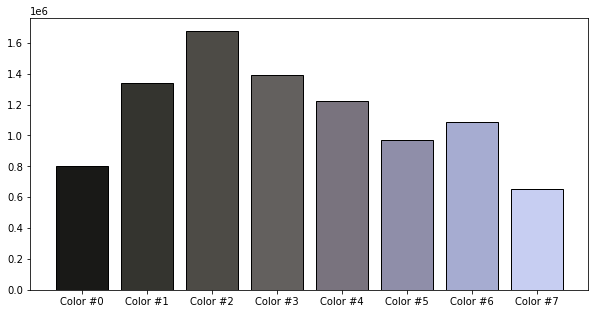

In [39]:
fig, ax = plt.subplots(figsize=(10,5))

ax.set_facecolor('white')
myBarChart = ax.bar(color_labels, number_of_pixels_of_a_color) # creating the barchart but NOT plotting yet...

for i in range(len(myBarChart)): # looping through all of the bars of my barchart...
    myBarChart[i].set_color(color_values[i]) # setting the color of the ith barchart to the list of colors
    myBarChart[i].set_edgecolor('black')

plt.show()

### Discussion
I was interested in doing this photo (also of Baxter) because it uses a filter -- specifically I used portrait mode on my phone camera. I was curious what changed in this photo. Similarly to Image 2, there seems to be a high contrast behind dark and light. However, instead of the browns of the other photos, this image seems to be heavily on the blue spectrum. I have noticed that a lot of filters (both on my phone, like this one, and on services like instagram) seem to emphasize the blues in the photo. I'm not sure if this is just trendy right now or if this generally looks better to our eyes. I am also intrigued that there seems to be such a regular gradient from dark to light blue in this histogram, I wonder if the filter helped to smooth out anormalities?

## Discussion Question: What are some issues you can think of in how color is rebinned from a full color image into an image with less colors with the functions provided?

I'm not an artist, but my sister is (and is actually getting her BFA in animation), and from watching her I have learned that even a small amount of the right color in the right place can make a huge difference in the final image. Sometimes when creating an image, you cannot even see all the colors that go into it, but they make a difference in the final product. Eliminating all those nuances may not tell you enough about the image -- for instance, in my second image, the green is very visually dominant, but doesn't appear in the histogram.

I also think that rebinning the colors creates a new image than the original image. I think rebinning the colors may create a situation where one color is overemphasized in the histogram as opposed to the original image, because many of the other colors were rebinned into one color, rather than in a blanaced way that maintains their original weights.